In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
import scanpy as sc
from tqdm import tnrange, tqdm_notebook
import matplotlib.backends.backend_pdf
from IPython.display import clear_output

import scvelo as scv
scv.settings.set_figure_params('scvelo', dpi_save=200, dpi=40, transparent=True)
scv.settings.verbosity = 3

/fast/users/peidlis_c/work/miniconda/envs/py36/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [3]:
data_path='/fast/scratch/users/peidlis_c/sodar_patient_organoid_data/'
signatures_path='/fast/work/users/peidlis_c/projects/sodar_patient_organoid_data/signatures/'

In [4]:
tab = pd.read_csv(signatures_path + 'cell_type_markers/cell_type_markers_epi.tsv', sep='\t')
tab = tab[tab.p_val_adj<0.01]
tab = tab[np.abs(tab.avg_logFC)> 0.75]
signature=dict([(ct, tab.gene.values[tab.cell_type_epi==ct]) for ct in pd.unique(tab.cell_type_epi)])

In [5]:
def get_signature(adata, signature):
    sc.settings.verbosity = 0
    for ids in signature.keys():   
        genes = signature[ids]
        genes = [genes] if np.isscalar(genes) else genes
        sc.tl.score_genes(adata, genes, score_name=ids, use_raw=False)

In [ ]:
donor='p013ot'
adata = scv.read(data_path+'by_donors/NB_AS_allconds_'+donor+'_priordynvelo.h5')
puredata = scv.read(data_path+'by_donors/NB_AS_allconds_'+donor+'.h5')
adata.obsm['X_umap']=puredata.obsm['X_umap']
del puredata
adata.obs['condition']='E'
adata.obs['condition'][adata.obs['batch']=='1']='W'
get_signature(adata, signature)
scv.pl.velocity_embedding_stream(adata, color=['condition',cps[0], cps[1]], vkey='dyn_velo', legend_loc=None, title=['condition']+types)

# SLAM velo umaps with plasticity

computing velocity embedding
    finished (0:00:01) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloNCOC.png


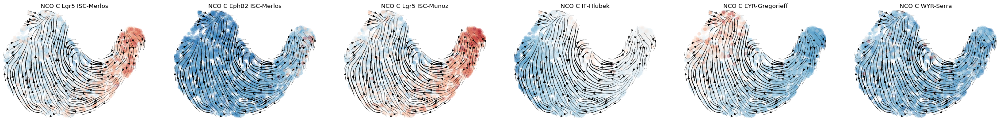

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloNCOE.png


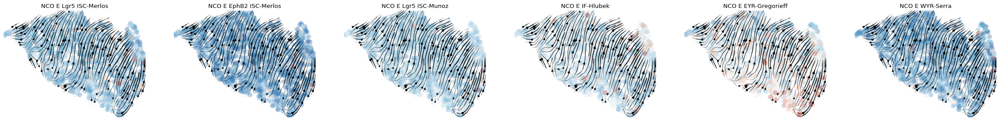

computing velocity embedding
    finished (0:00:01) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloNCOW.png


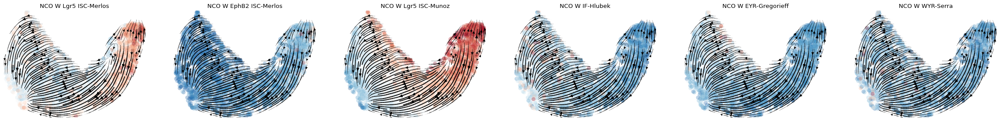

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop009otC.png


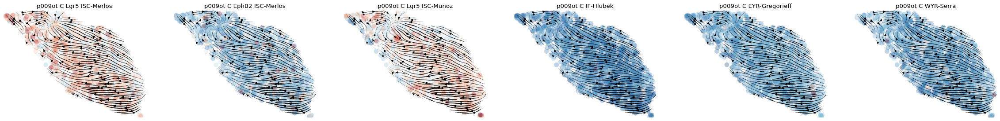

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop009otE.png


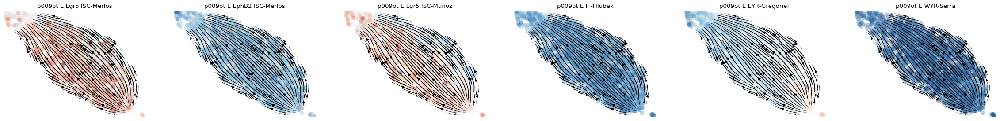

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop009otW.png


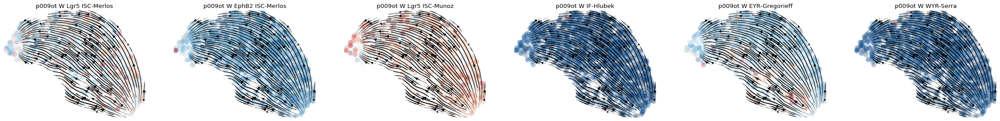

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop013otC.png


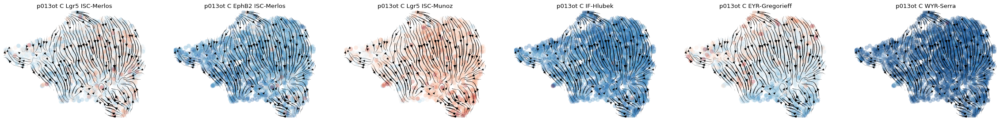

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop013otE.png


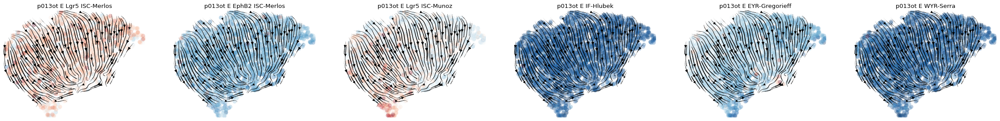

computing velocity embedding
    finished (0:00:01) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMvelop013otW.png


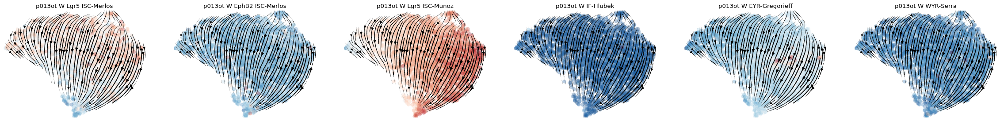

In [7]:
tab = pd.read_excel(signatures_path+'cell_type_markers/CRC-related_stem_cell_signatures.xlsx', index_col=None, header=0, skiprows=[1])
name = 'CRC-related_stem_cell_signatures'
signature = dict([(ids, tab[ids][~pd.isna(tab[ids])].values) for ids in tab.columns])
for donor in ['NCO', 'p009ot', 'p013ot']:
    for letter in ['E', 'W']:
        adata = scv.read(data_path+'NB_AS_'+letter+'/processed/NB_AS_'+letter+'_'+donor+'SLAMvelo.h5')
        # new umap
        bdata = adata.copy()
        sc.pp.filter_genes_dispersion(bdata, n_top_genes=2000)
        sc.tl.pca(bdata, n_comps=50)
        sc.pp.neighbors(bdata)
        sc.tl.umap(bdata)
        adata.obsm = bdata.obsm
        
        get_signature(adata, signature)
        title = [donor + ' ' + letter + ' ' + sig for sig in signature.keys()]
        scv.pl.velocity_embedding_stream(adata, vkey='dyn_velo', color=list(signature.keys()), title = title, colorbar=False, save='SLAMvelo'+donor+letter+'.png')

computing velocity embedding
    finished (0:00:01) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSNCOC.png


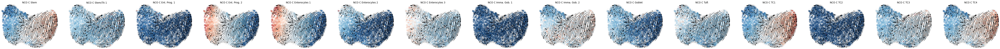

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSNCOE.png


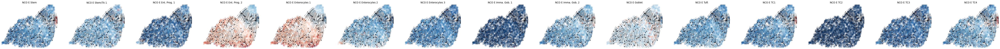

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSNCOW.png


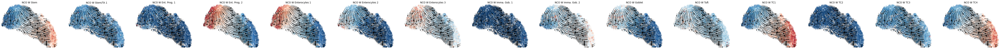

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp009otC.png


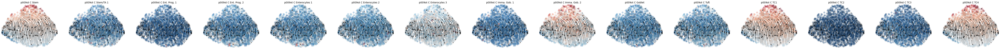

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp009otE.png


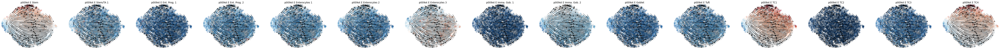

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp009otW.png


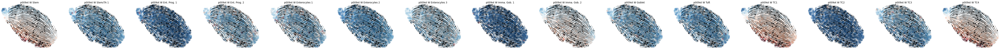

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp013otC.png


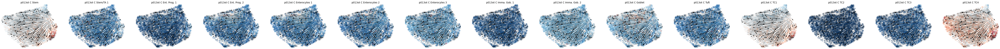

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp013otE.png


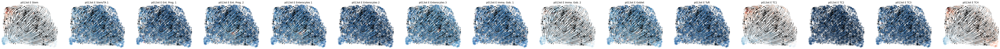

computing velocity embedding
    finished (0:00:00) --> added
    'dyn_velo_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_SLAMveloFLORIANSIGSp013otW.png


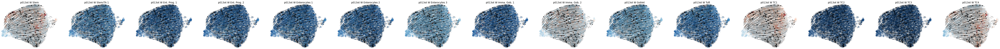

In [16]:
tab = pd.read_csv(signatures_path + 'cell_type_markers/cell_type_markers_epi.tsv', sep='\t')
tab = tab[tab.p_val_adj<0.01]
tab = tab[np.abs(tab.avg_logFC)> 0.75]
signature=dict([(ct, tab.gene.values[tab.cell_type_epi==ct]) for ct in pd.unique(tab.cell_type_epi)])
for donor in ['NCO', 'p009ot', 'p013ot']:
    for letter in ['C', 'E', 'W']:
        adata = scv.read(data_path+'NB_AS_'+letter+'/processed/NB_AS_'+letter+'_'+donor+'SLAMvelo.h5')
        get_signature(adata, signature)
        title = [donor + ' ' + letter + ' ' + sig for sig in signature.keys()]
        scv.pl.velocity_embedding_stream(adata, vkey='dyn_velo', color=list(signature.keys()), title = title, colorbar=False, save='SLAMveloFLORIANSIGS'+donor+letter+'.png')

In [ ]:
tab = pd.read_csv(signatures_path + 'cell_type_markers/cell_type_markers_epi.tsv', sep='\t')
tab = tab[tab.p_val_adj<0.01]
tab = tab[np.abs(tab.avg_logFC)> 0.75]
signature=dict([(ct, tab.gene.values[tab.cell_type_epi==ct]) for ct in pd.unique(tab.cell_type_epi)])
for donor in ['NCO', 'p009ot', 'p013ot']:
    for letter in ['C', 'E', 'W']:
        adata = scv.read(data_path+'NB_AS_'+letter+'/processed/NB_AS_'+letter+'_'+donor+'SLAMvelo.h5')
        get_signature(adata, signature)
        title = [donor + ' ' + letter + ' ' + 'plasticity' for sig in signature.keys()]
        scv.pl.velocity_embedding_stream(adata, vkey='dyn_velo', color='plasticity', title = title, colorbar=False, save='SLAMveloFLORIANSIGS'+donor+letter+'.png')